# Setup

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys

sys.path.append("..")

from src.utils import read_yaml, read_tiff, save_yaml
from src.metrics import evaluate_metrics,evaluate_component_metrics
from sample_selection import get_components_stats

import os
from os.path import join

import pandas as pd
import numpy as np

import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.rcsetup as rcsetup

from skimage.measure import label
from sample_selection import filter_components_by_geometric_property, get_labels_delta, filter_components_by_mask
import yaml
from scipy.ndimage import gaussian_filter

from skimage.color import label2rgb
# sns.set_style("whitegrid")

In [3]:
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False

plt.rcParams['xtick.labelbottom'] = False
plt.rcParams['ytick.labelleft'] = False

In [4]:
args = read_yaml("../args.yaml")

ROOT_PATH = r"C:\Users\ziull\OneDrive\Documentos\Estudos\TCC\multi-task-fcn"

args["data_path"] = join(ROOT_PATH, "19.0_version_data")

# Carregando de dados

- Leitura da imagem de satélite


In [5]:
# Load orthoimage with 3 bands
ORTHOIMAGE = np.moveaxis( read_tiff(join(ROOT_PATH, args.ortho_image)), 0, 2)[:, :, [5,3,2]]

- Leitura da ground truth segmentation

In [6]:
TRAIN_GT_MAP = read_tiff(join(ROOT_PATH, args.train_segmentation_path))

TEST_GT_MAP = read_tiff(join(ROOT_PATH, args.test_segmentation_path))

COMP_TEST_GT = label(TEST_GT_MAP)

- Leitura dos mapas de probabilidade e mapa de distâncias do modelo 

In [7]:
CURRENT_ITER_FOLDER = join(ROOT_PATH, args.data_path, "iter_001")

depth_map = read_tiff(join(CURRENT_ITER_FOLDER, "raster_prediction/depth_itcFalse_0.9.TIF"))
pred_map = read_tiff(join(CURRENT_ITER_FOLDER, "raster_prediction/join_class_itcFalse_0.9.TIF"))
prob_map = read_tiff(join(CURRENT_ITER_FOLDER, "raster_prediction/join_prob_itcFalse_0.9.TIF"))

# Utils

In [8]:
def add_mask(mask_ref, left, right, top, down):
    
    image = ORTHOIMAGE[top:down, left:right].copy()
    # image = image/image.max()
    image = (image - image.min()) / (np.quantile(image, 0.99) - image.min())

    # mask = np.where(comp_map[top:down, left:right] > 0, 1, 0)*0.3
    mask = mask_ref[top:down, left:right]

    image[:,:, 0] += mask * 0.7
    image[:,:, 1] += mask * 0.4
    image[:,:, 2] += mask * 0.4
    
    return image

In [9]:
def square_comp_coords(comp_id, comp_map):
    coords = np.argwhere(comp_map == comp_id)

    down, top = coords[:, 0].max(),  coords[:, 0].min()

    right, left = coords[:, 1].max(),  coords[:, 1].min()

    # adding margin
    margin = 0.03

    # down += int(down*margin)
    # top -= int(top*margin)

    # right += int(right*margin)
    # left -= int(left*margin)
    dim = 256
    down += dim
    top -= dim

    right += dim
    left -= dim

    #### create a square ###
    if np.abs(top-down) > np.abs(right - left):
        right = left + np.abs(top-down)

    if np.abs(top-down) < np.abs(right - left):
        down = top + np.abs(right - left)
    
    return left, right, top, down


def extract_comp_squares(comp_id, comp_map, mask_ref):
    left, right, top, down = square_comp_coords(comp_id, comp_map,)

    image = ORTHOIMAGE[top:down, left:right].copy()
    # image = image/image.max()
    image = (image - image.min()) / (image.max() - image.min())

    # mask = np.where(comp_map[top:down, left:right] > 0, 1, 0)*0.3
    mask = mask_ref[top:down, left:right]

    image[:,:, 0] += mask * 0.7
    image[:,:, 1] += mask * 0.4
    image[:,:, 2] += mask * 0.4

    return image

# Testes de seleção de samples comparando com os dados de teste

In [10]:
def add_mask(mask_ref, left, right, top, down):
    
    image = ORTHOIMAGE[top:down, left:right].copy()
    # image = image/image.max()
    image = (image - image.min()) / (np.quantile(image, 0.99) - image.min())

    # mask = np.where(comp_map[top:down, left:right] > 0, 1, 0)*0.3
    mask = mask_ref[top:down, left:right]

    image[:,:, 0] += mask * 0.7
    image[:,:, 1] += mask * 0.1
    image[:,:, 2] += mask * 0.7
    
    return image

## Usando conjunto de teste fixo

Selecionando algumas amostras aleatoriamente

In [11]:
test_comp_ids = np.unique(COMP_TEST_GT)
test_comp_ids = test_comp_ids[np.nonzero(test_comp_ids)].copy()

np.random.seed(1)
# Componentes selecionados da base e teste
selected_comp_gt = np.random.choice(test_comp_ids, size = 10, replace = False)

np.unique(TEST_GT_MAP[np.isin(COMP_TEST_GT, selected_comp_gt)])

array([ 3,  4,  5,  7,  8,  9, 10, 12], dtype=uint8)

## Simulação de seleção de componentes

In [12]:
def simulate(new_pred_map):
    np.random.seed(123)

    test_images = []
    predicted_images = []
    prob_images = []
    depth_images = []

    NUM_IMAGES = 5

    for j, comp_id in enumerate(selected_comp_gt):
        # coords = square_comp_coords(comp_id, all_labels_comp)
        coords = square_comp_coords(comp_id, COMP_TEST_GT)

        # raw_images.append(ORTHOIMAGE[coords[0] : coords[1], coords[2]:coords[3], :]/255)

        test_images.append( 
            add_mask(np.where(COMP_TEST_GT > 0, 1, 0)*0.5, *coords)
        )

        predicted_images.append(add_mask(np.where(new_pred_map > 0, 1, 0)*0.5, *coords))

        prob_images.append(add_mask(np.where(new_pred_map > 0, prob_map, 0)*0.7, *coords))

        depth_images.append(add_mask((np.where(new_pred_map > 0, depth_map + 0.1, 0)), *coords))
        



    # for j in range(len(predicted_images)):
        fig, ax = plt.subplots(nrows=1, ncols = 4, sharex=False, sharey=False)

        fig.set_size_inches(12, 3)
        
        ax[0].imshow(test_images[j], interpolation='nearest')

        ax[1].imshow(predicted_images[j], interpolation='nearest')
        
        ax[2].imshow(prob_images[j], interpolation='nearest')

        ax[3].imshow(depth_images[j], interpolation='nearest')


        ax[0].set_title("Ground Truth test:", fontsize = 8)
        ax[1].set_title("Predicted:", fontsize = 8,)
        ax[2].set_title("Prob:", fontsize = 8)
        ax[3].set_title("Depth:", fontsize = 8)

        fig.tight_layout()

        plt.show()



# prob_gauss = gaussian_filter(prob_map, 1)
# depth_gauss = gaussian_filter(depth_map, 1)

# # new_pred_map = np.where((depth_gauss > 0.1) & (prob_gauss > 0.80), pred_map, 0)

# new_pred_map = np.where((depth_gauss > 0.15) & (prob_gauss > 0.9), pred_map, 0)

# # new_pred_map = np.where((depth_gauss + prob_gauss) > 1.3, pred_map, 0)

# simulate(new_pred_map)

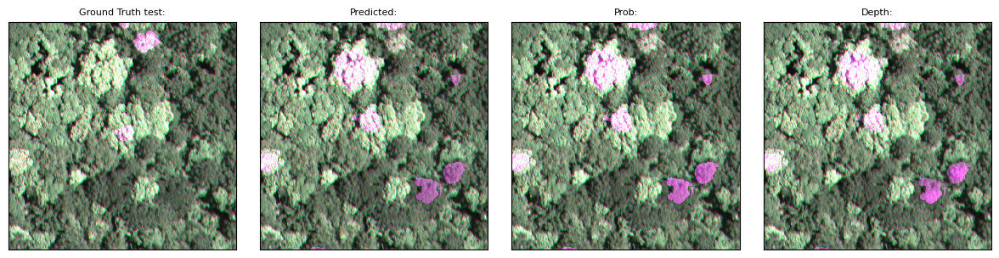

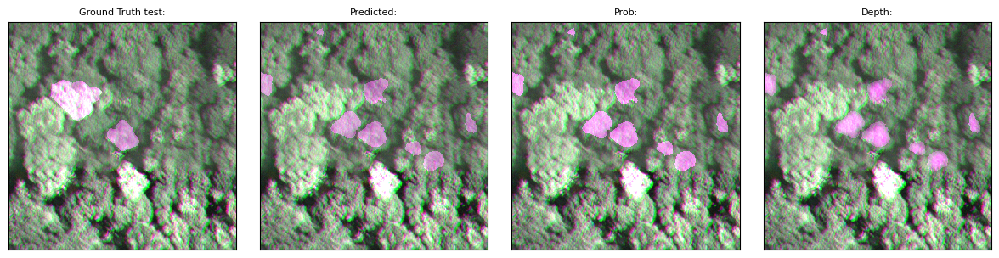

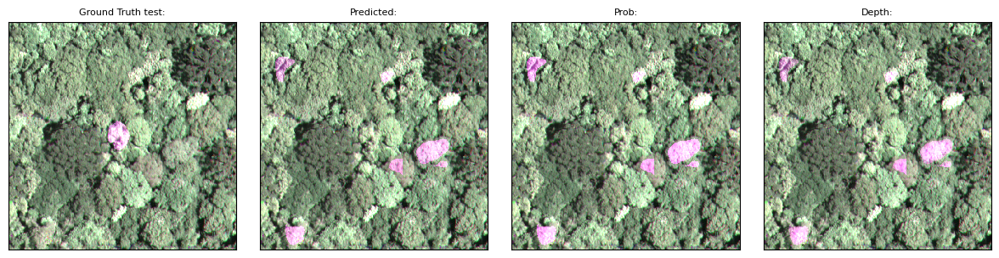

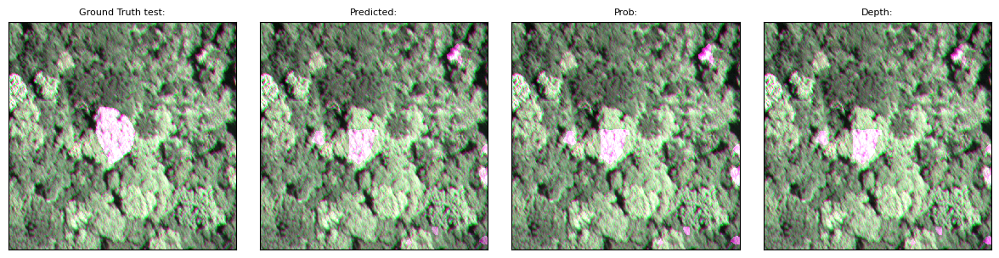

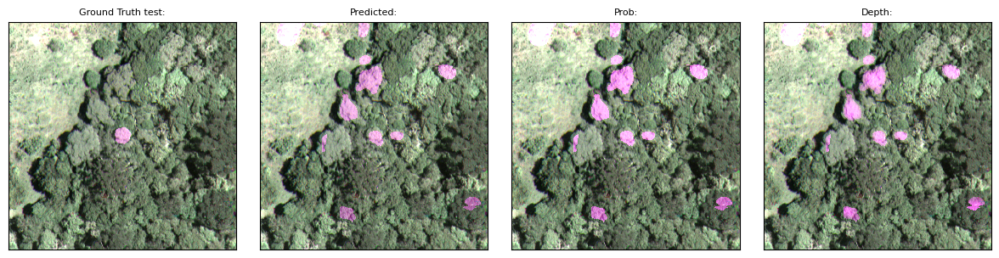

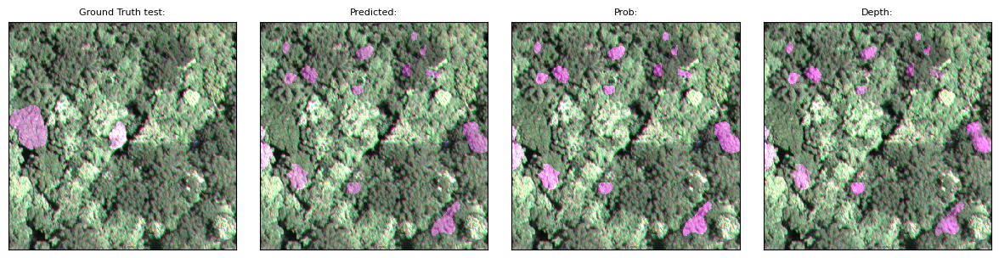

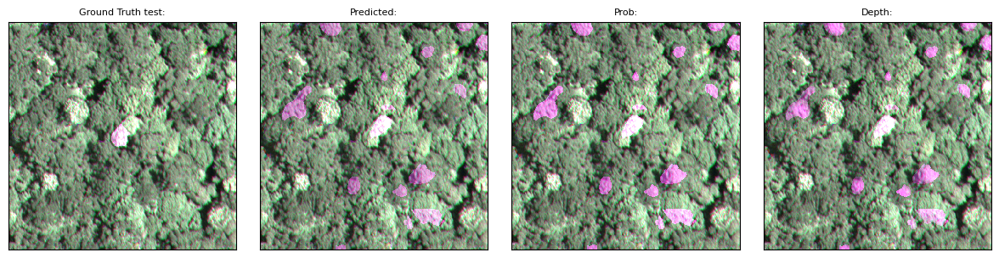

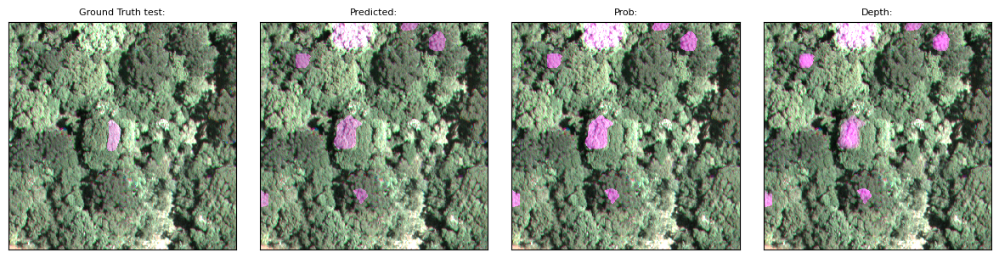

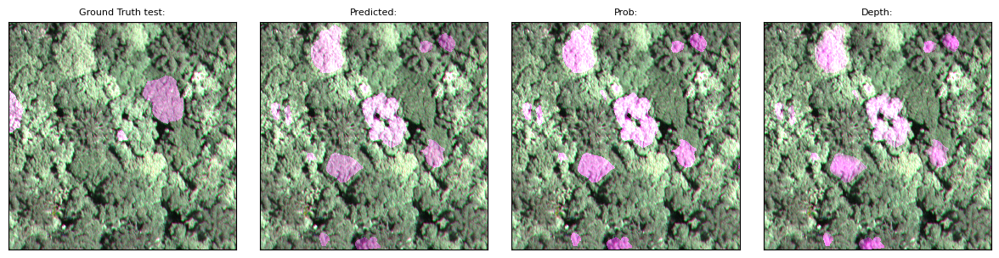

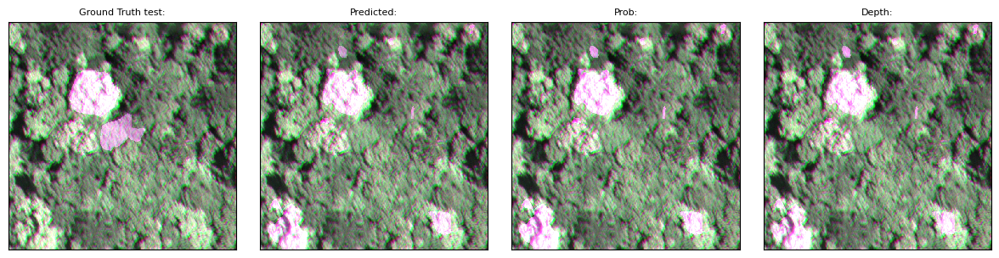

In [13]:
prob_gauss = gaussian_filter(prob_map, 1)
depth_gauss = gaussian_filter(depth_map, 1)

# new_pred_map = np.where(pred_map, 0)

new_pred_map = np.where( ((depth_gauss+prob_gauss) > 1.2) & (prob_gauss > 0.95), pred_map, 0)

# new_pred_map = np.where( (prob_gauss+depth_gauss) > 1.2 , new_pred_map, 0)

filter_components_by_geometric_property(
    new_pred_map,
    200,
    np.inf,
    property = "area"
)

filter_components_by_geometric_property(
    new_pred_map,
    0.8,
    np.inf,
    property = "solidity"
)

simulate(new_pred_map)

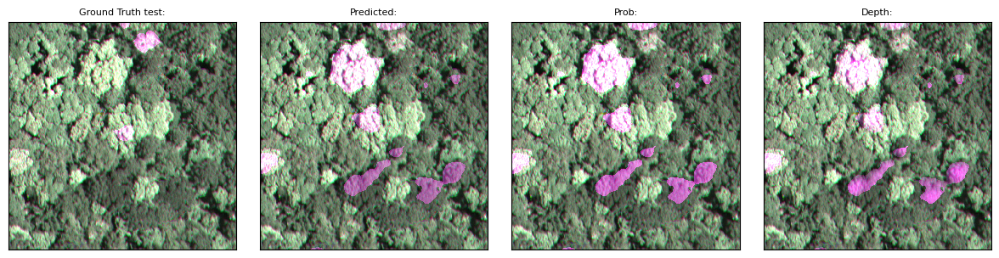

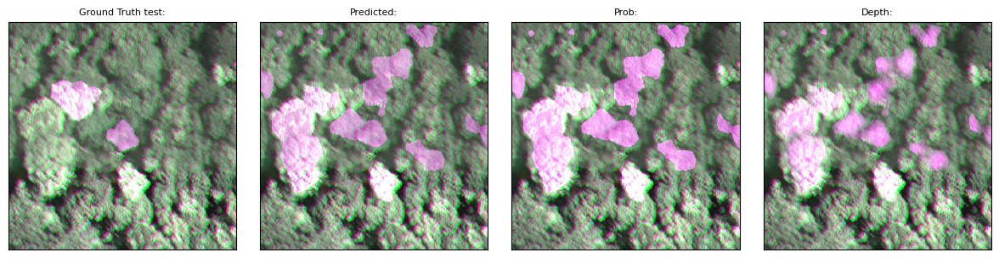

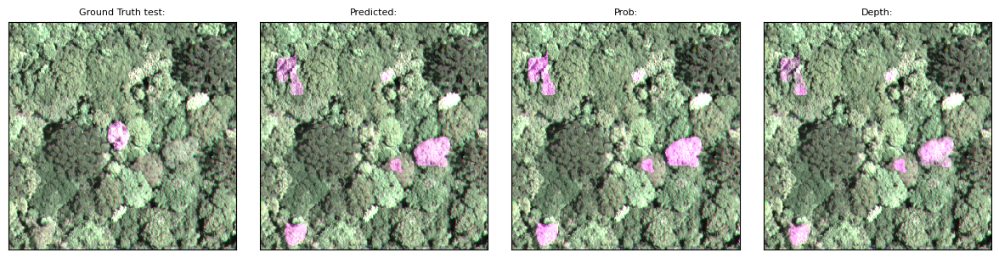

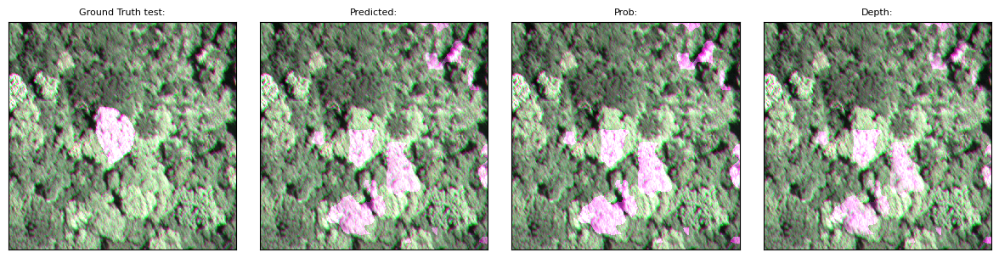

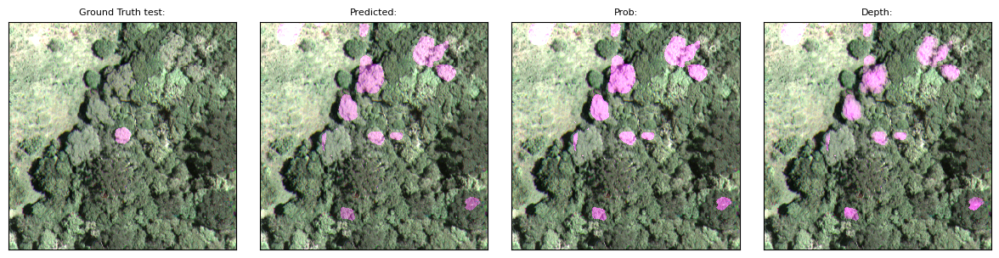

KeyboardInterrupt: 

In [14]:
prob_gauss = gaussian_filter(prob_map, 3)
depth_gauss = gaussian_filter(depth_map, 3)

# new_pred_map = np.where(pred_map, 0)

new_pred_map = np.where( (depth_gauss + prob_gauss > 1.1) & (prob_gauss > 0.95), pred_map, 0)

# new_pred_map = np.where( (prob_gauss+depth_gauss) > 1.2 , new_pred_map, 0)

simulate(new_pred_map)

# Busca bruta

In [15]:
# ORTHOIMAGE[]
center = ORTHOIMAGE.shape[0]//2, ORTHOIMAGE.shape[1]//2

prob_gauss = gaussian_filter(prob_map, 3)
depth_gauss = gaussian_filter(depth_map, 3)


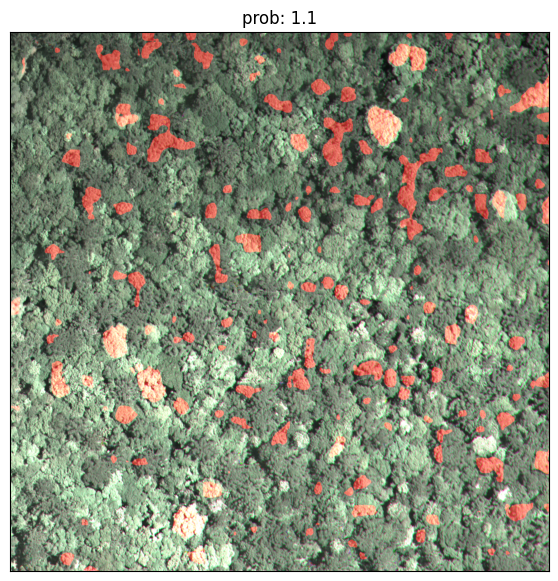

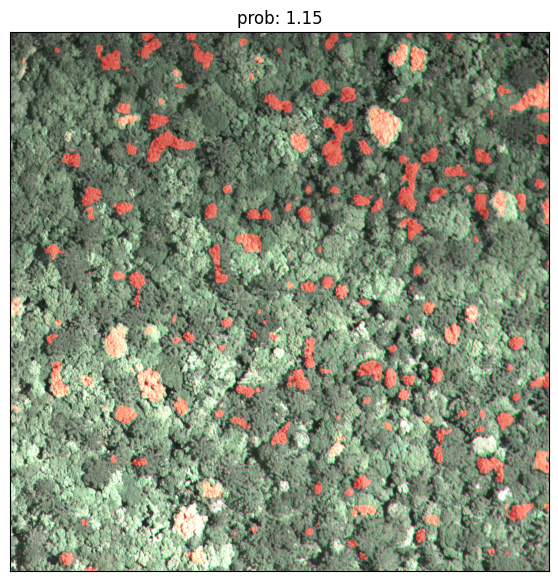

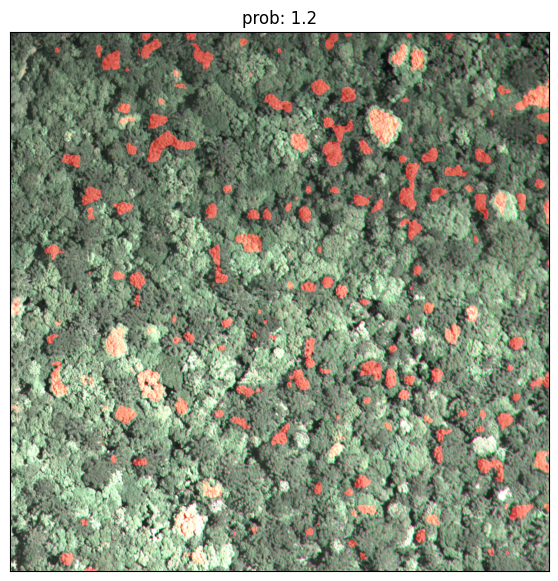

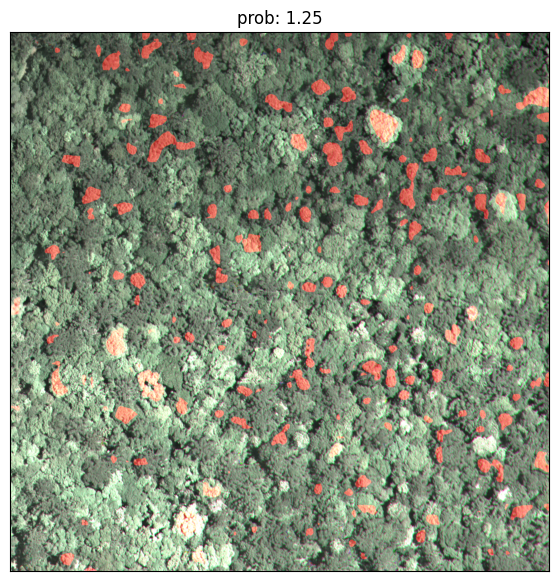

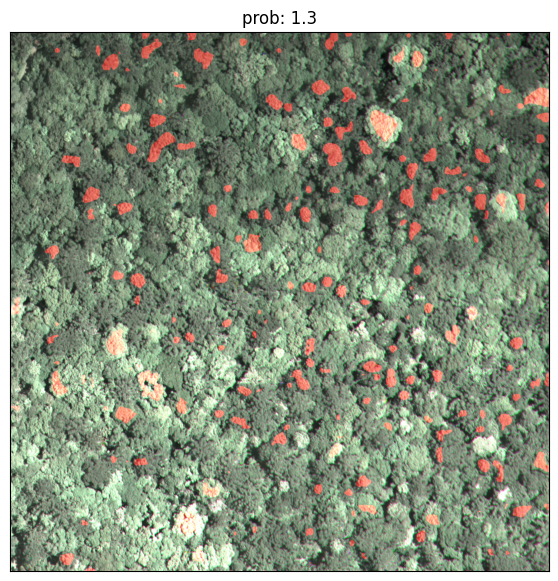

In [ ]:
dim = 1024
image_raw = ORTHOIMAGE[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim]
image_raw = (image_raw - image_raw.min())/(np.quantile(image_raw, 0.99) - image_raw.min())



for soma in [1.1, 1.15 ,1.2, 1.25, 1.3]:
    image_raw_copy = image_raw.copy()        

    new_pred_map = np.where( ((depth_gauss+ prob_gauss) > soma) & (prob_gauss > 0.95) , pred_map, 0)
    
    mask = np.where(new_pred_map[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim] > 0, 1, 0)*0.3

    mask_gt = np.where(TEST_GT_MAP[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim] > 0, 1, 0)
    
    image_raw_copy[:,:, 0] += mask*0.7
    image_raw_copy[:,:, 0] += mask*0.3
    image_raw_copy[:,:, 0] += mask*0.7


    # image_raw[:,:, 0] -= mask_gt*0.3
    # image_raw[:,:, 0] -= mask_gt*0.3
    # image_raw[:,:, 0] -= mask_gt*0.3

    plt.figure(figsize= (7, 7))
    plt.title(f"prob: {soma}")
    plt.imshow(image_raw_copy)
    plt.show()


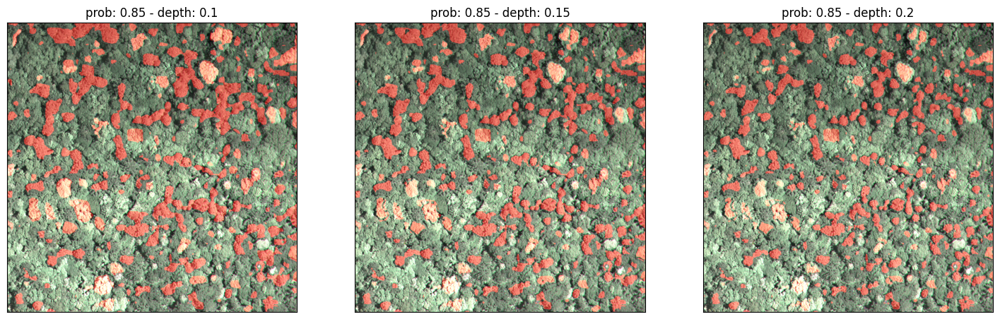

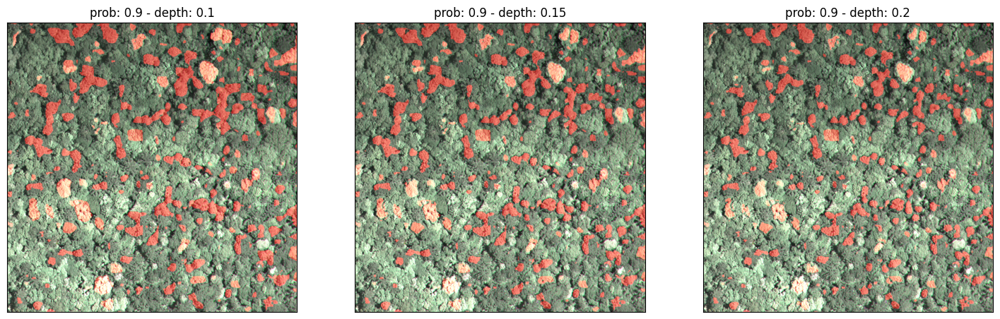

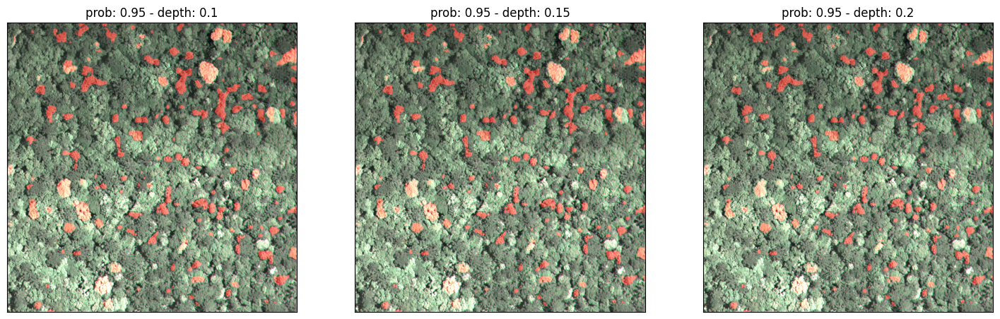

In [16]:
dim = 1024
image_raw = ORTHOIMAGE[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim]
image_raw = (image_raw - image_raw.min())/(np.quantile(image_raw, 0.99) - image_raw.min())

probs = [0.85, 0.9, 0.95]
depths = [0.1, 0.15, 0.2]

for i, prob in enumerate(probs):

    fig, ax = plt.subplots(ncols = len(depths), figsize = (len(depths)*6, 10))

    for j, distance_map in enumerate(depths):
        
        image_raw_copy = image_raw.copy()        

        new_pred_map = np.where( (depth_gauss > distance_map) & (prob_gauss > prob), pred_map, 0)
        
        mask = np.where(new_pred_map[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim] > 0, 1, 0)*0.3

        mask_gt = np.where(TEST_GT_MAP[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim] > 0, 1, 0)
        
        image_raw_copy[:,:, 0] += mask*0.7
        image_raw_copy[:,:, 0] += mask*0.3
        image_raw_copy[:,:, 0] += mask*0.7


        # image_raw[:,:, 0] -= mask_gt*0.3
        # image_raw[:,:, 0] -= mask_gt*0.3
        # image_raw[:,:, 0] -= mask_gt*0.3

        # ax[i].figure()
        ax[j].set_title(f"prob: {prob} - depth: {distance_map}")
        ax[j].imshow(image_raw_copy)
        
    
    plt.show()





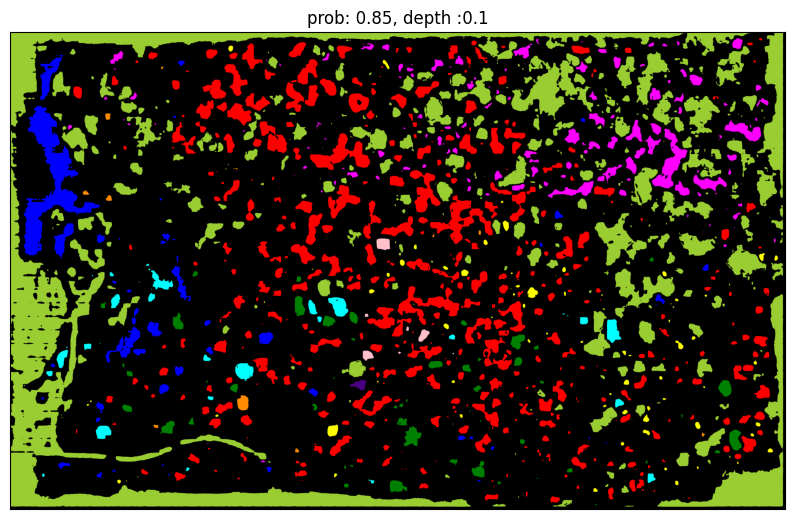

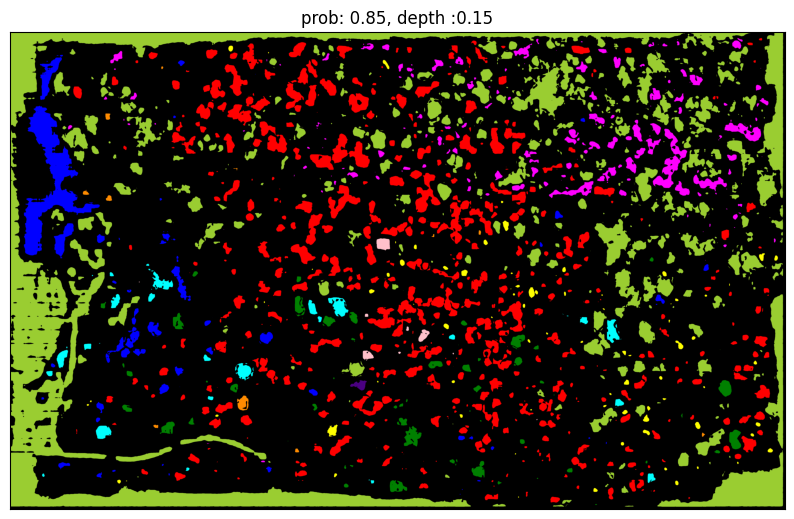

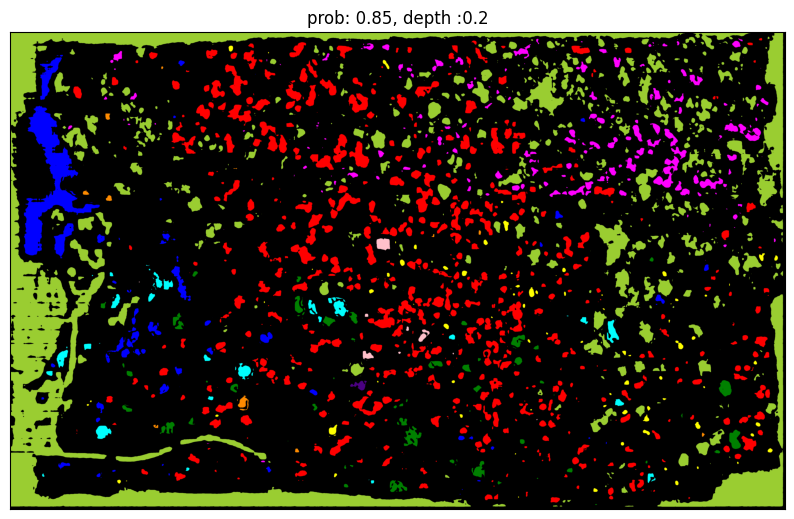

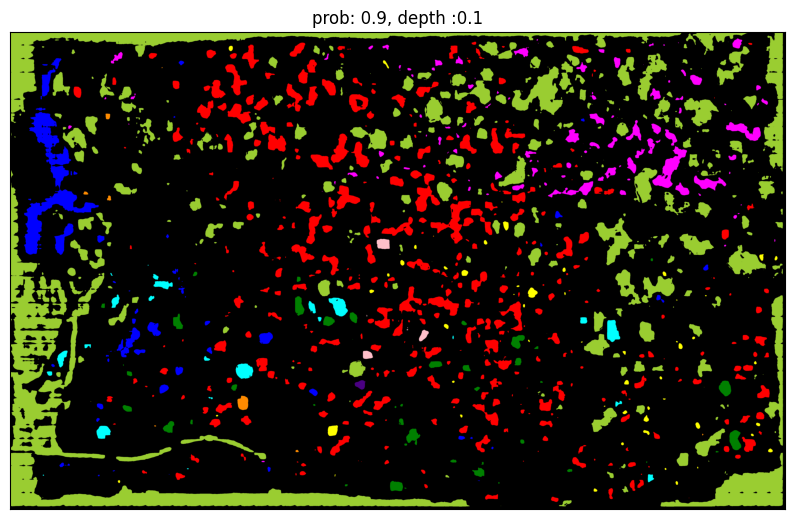

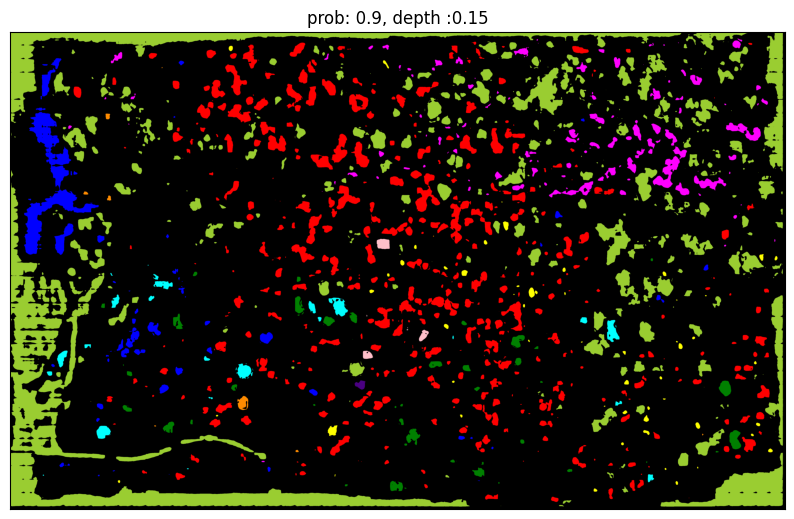

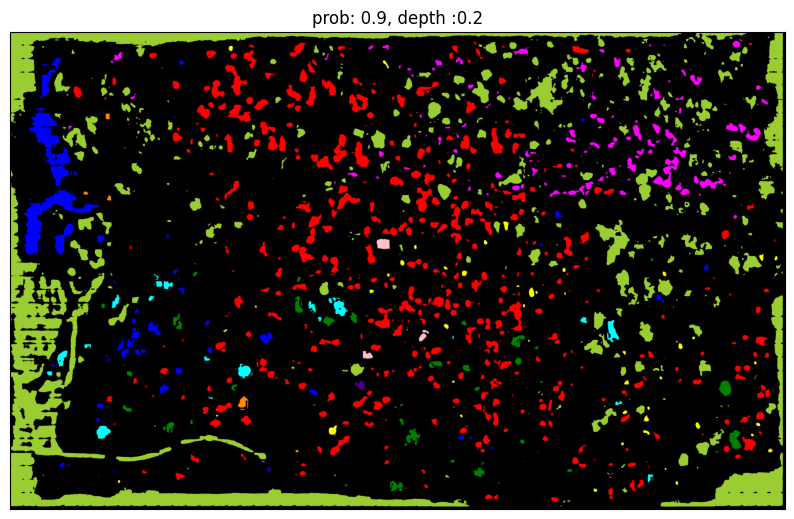

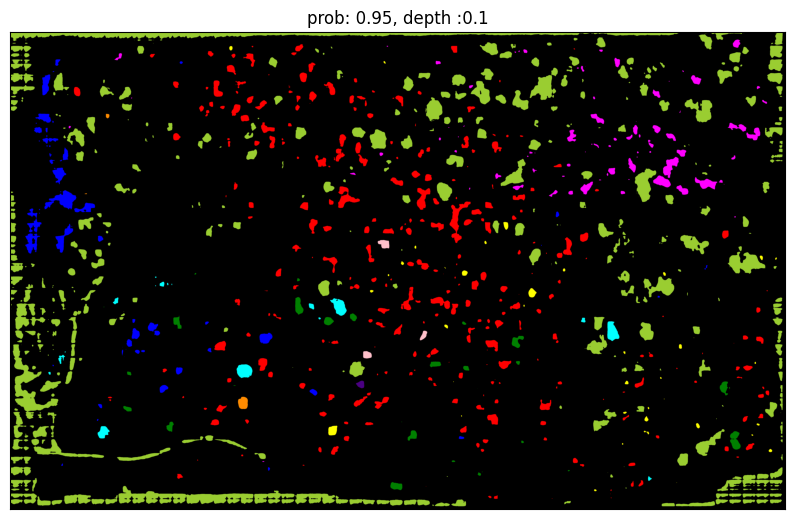

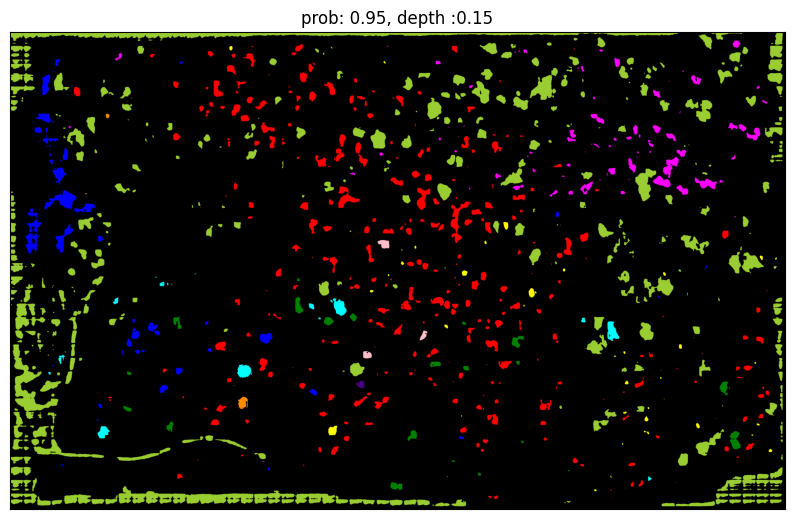

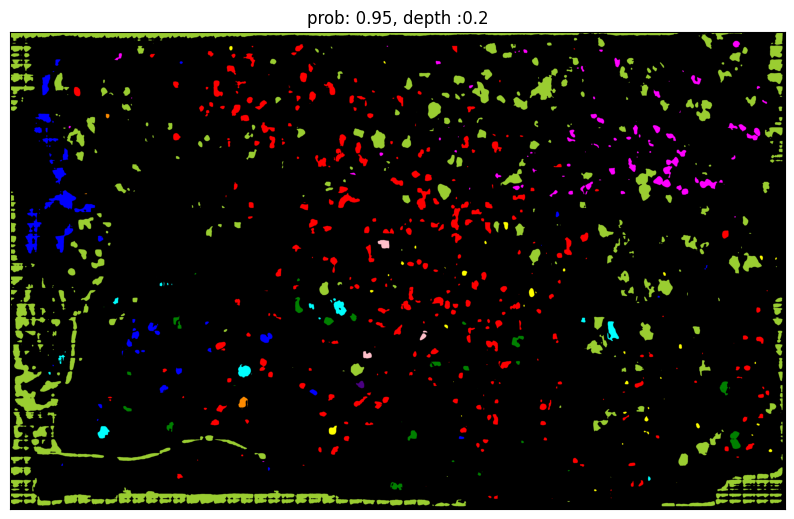

In [18]:
probs = [0.85, 0.9, 0.95]
depths = [0.1, 0.15, 0.2]

for i, prob in enumerate(probs):
    
    for j, distance_map in enumerate(depths):
        
        new_pred_map = np.where( (depth_gauss > distance_map) & (prob_gauss > prob), pred_map, 0)
        
        plt.figure(figsize=(10, 20))
        plt.title(f"prob: {prob}, depth :{distance_map}")
        # plt.imshow(new_pred_map, cmap = "tab20b")
        plt.imshow(label2rgb(new_pred_map))
        plt.show()

# Escolhi o parâmetro prob 0.9 e depth 0.2

In [103]:
COMP_TRAIN_GT = label(TRAIN_GT_MAP)

In [104]:
gt_stats = get_components_stats(COMP_TRAIN_GT, TRAIN_GT_MAP)

In [112]:
tree_gt_stats = gt_stats.groupby("tree_type")[["extent", "solidity", "eccentricity", "area"]].median()
tree_gt_stats.columns  = "ref_" + tree_gt_stats.columns 

In [483]:
final_pred_map = np.where((depth_gauss > 0.2) & (prob_map > 0.9), pred_map, 0)

filter_components_by_mask(final_pred_map)

final_pred_map = get_labels_delta(TRAIN_GT_MAP, final_pred_map)

final_comp_map = label(final_pred_map)

Filtering components out of the area of the experiment


100%|██████████| 383/383 [00:17<00:00, 21.92it/s]


In [502]:
final_comp_map = label(final_pred_map)

In [503]:
comp_stats = get_components_stats(final_comp_map,final_pred_map).reset_index()

comp_stats = comp_stats.merge(tree_gt_stats, on = "tree_type", how = "left")

comp_stats["dist_area"] =  np.abs(comp_stats["area"] - comp_stats["ref_area"])/comp_stats["ref_area"]

comp_stats["diff_area"] =  (comp_stats["area"] - comp_stats["ref_area"])/comp_stats["ref_area"]

comp_stats["diff_ecc"] =  (comp_stats["eccentricity"] - comp_stats["ref_eccentricity"])

comp_stats["diff_soli"] =  (comp_stats["solidity"] - comp_stats["ref_solidity"])

comp_stats["diff_ext"] =  (comp_stats["extent"] - comp_stats["ref_extent"])

comp_stats["score"] = (comp_stats["diff_soli"] + comp_stats["diff_ext"])/2

In [525]:
(tree_gt_stats["ref_area"] - tree_gt_stats["ref_area"]*0.3).sort_values()

tree_type
12     840.00
10     850.15
13    1499.40
4     1511.30
7     1605.80
3     1757.00
2     2362.15
5     2609.60
6     3138.10
1     3139.15
14    3567.20
8     3602.90
9     4225.90
11    8576.40
Name: ref_area, dtype: float64

In [472]:
# final_pred_map = np.where(TRAIN_GT_MAP != 0, 0, final_pred_map)

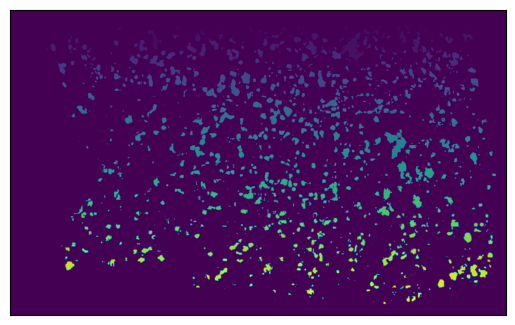

In [504]:
plt.imshow(final_comp_map)

In [505]:
comp_stats.groupby("tree_type").size().sort_values()

tree_type
6       2
13      3
9       8
12      9
7      17
11     28
8      34
2      47
3      68
5      70
4     150
10    429
1     559
dtype: int64

In [528]:
selected_comp = comp_stats[comp_stats["area"] > 500].copy()

selected_pred =  np.where(np.isin(final_comp_map, selected_comp["label"].unique()), final_pred_map, 0)

# plt.figure(figsize= (20, 10))
# plt.imshow(label2rgb(selected_pred))
# plt.show()

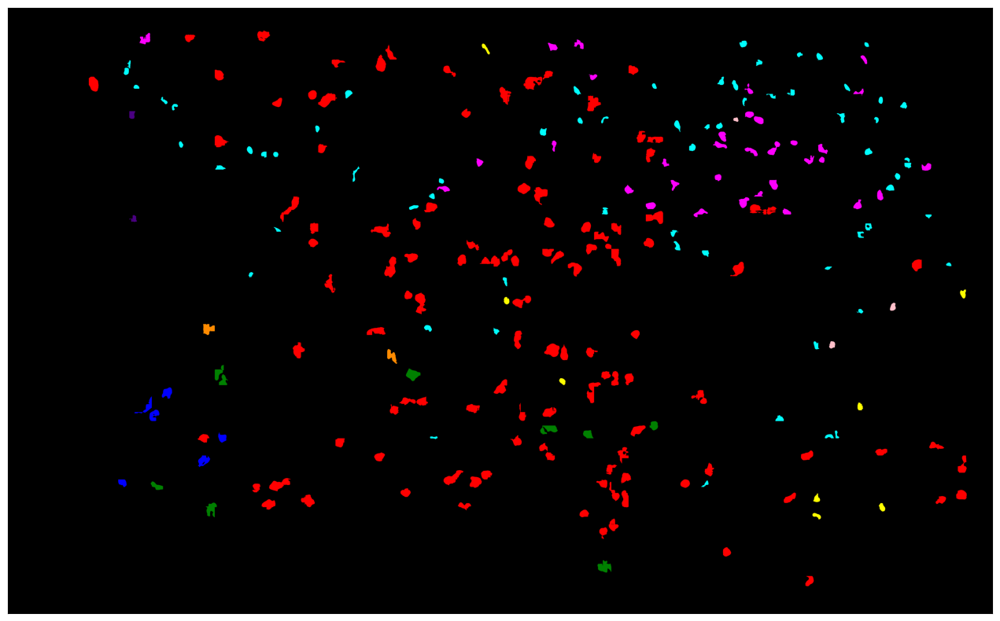

In [530]:
selected_comp = selected_comp[selected_comp["dist_area"] < 0.5].copy()

selected_pred =  np.where(np.isin(final_comp_map, selected_comp["label"].unique()), final_pred_map, 0)

plt.figure(figsize= (20, 10))
plt.imshow(label2rgb(selected_pred))
plt.show()

In [460]:
# selected_comp_temp = selected_comp[selected_comp["diff_area"] > 0.1].copy()

# selected_pred =  np.where(np.isin(final_comp_map, selected_comp_temp["label"].unique()), final_pred_map, 0)

# plt.figure(figsize= (20, 10))
# plt.imshow(label2rgb(selected_pred))
# plt.show()

In [453]:
# selected_comp_temp = selected_comp[selected_comp["score"] <= -0.01].copy()

# selected_pred =  np.where(np.isin(final_comp_map, selected_comp_temp["label"].unique()), final_pred_map, 0)

# plt.figure(figsize= (20, 10))
# plt.imshow(label2rgb(selected_pred))
# plt.show()

In [508]:
selected_comp["diff_soli"].sort_values()

1027   -0.495690
431    -0.386243
158    -0.346833
1160   -0.289457
508    -0.286298
          ...   
661     0.053054
241     0.053159
347     0.055094
166     0.056963
528     0.058470
Name: diff_soli, Length: 240, dtype: float64

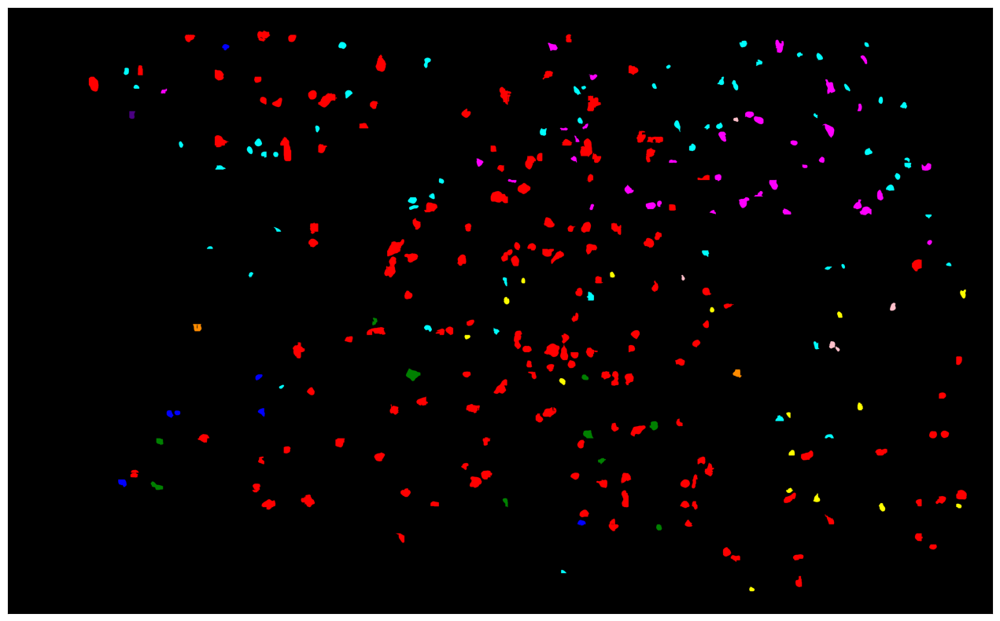

In [517]:
selected_comp = selected_comp[selected_comp["diff_soli"] >= -0.1].copy()

selected_pred =  np.where(np.isin(final_comp_map, selected_comp["label"].unique()), final_pred_map, 0)

plt.figure(figsize= (20, 10))

plt.imshow(label2rgb(selected_pred))

plt.show()

In [433]:
# selected_comp_temp = selected_comp[selected_comp["diff_ext"] >= -0.05].copy()

# selected_pred =  np.where(np.isin(final_comp_map, selected_comp_temp["label"].unique()), final_pred_map, 0)

# plt.figure(figsize= (20, 10))
# plt.imshow(label2rgb(selected_pred))
# plt.show()

In [434]:
# selected_comp.sort_values("score", ascending=False, inplace = True)

# selected_comp = selected_comp.groupby("tree_type").head(5)

# selected_pred =  np.where(np.isin(final_comp_map, selected_comp_temp["label"].unique()), final_pred_map, 0)

# plt.figure(figsize= (20, 10))
# plt.imshow(label2rgb(selected_pred))
# plt.show()

In [416]:
# from skimage.morphology import convex_hull_image, convex_hull_object
# from tqdm import tqdm


# labeled_im = label(selected_pred, background=0)
# convex_obj = np.zeros(selected_pred.shape, dtype=bool)
# convex_img = np.zeros(selected_pred.shape, dtype=bool)

# for i in tqdm(range(1, labeled_im.max() + 1, 50)):
#     convex_obj = convex_hull_image(labeled_im == i)
#     convex_img = np.logical_or(convex_img, convex_obj)
#     print(i)



# plt.imshow(convex_img)

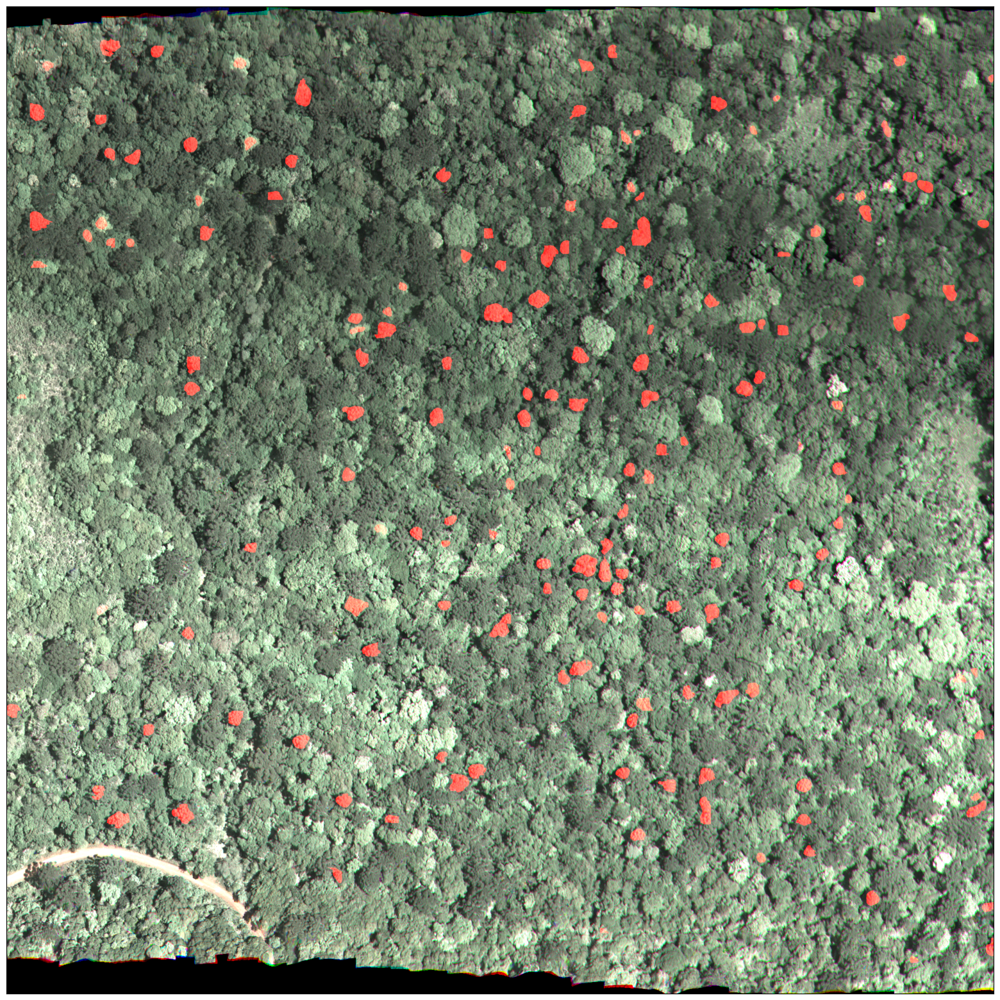

In [512]:
selected_pred =  np.where(np.isin(final_comp_map, selected_comp["label"].unique()), final_pred_map, 0)

dim = 2000
image_raw = ORTHOIMAGE[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim]
image_raw = (image_raw - image_raw.min())/(np.quantile(image_raw, 0.99) - image_raw.min())


image_raw_copy = image_raw.copy()        


mask = np.where(selected_pred[center[0] - dim : center[0] + dim, center[1] - dim : center[1] + dim] > 0, 1, 0)

image_raw_copy[:,:, 0] += mask*0.7
image_raw_copy[:,:, 0] += mask*0.7
image_raw_copy[:,:, 0] += mask*0.7

plt.figure(figsize= (20, 20))

plt.imshow(image_raw_copy)
plt.show()


In [232]:
comp_stats[comp_stats["dist_soli"] < 0.1]

,label,area,convex_area,bbox_area,extent,solidity,eccentricity,orientation,centroid-0,centroid-1,...,tree_type,ref_extent,ref_solidity,ref_eccentricity,ref_area,dist_area,dist_ecc,dist_soli,dist_ext,score
991,992,1.0,1.0,1.0,1.000000,1.000000,0.000000,-0.785398,1982.000000,3473.000000,...,1,0.634941,0.927722,0.788872,4484.5,0.999777,0.788872,0.072278,0.365059,0.306552
1626,1627,1.0,1.0,1.0,1.000000,1.000000,0.000000,-0.785398,3263.000000,6319.000000,...,1,0.634941,0.927722,0.788872,4484.5,0.999777,0.788872,0.072278,0.365059,0.306552
1785,1786,1.0,1.0,1.0,1.000000,1.000000,0.000000,-0.785398,3788.000000,1933.000000,...,1,0.634941,0.927722,0.788872,4484.5,0.999777,0.788872,0.072278,0.365059,0.306552
1579,1580,1.0,1.0,1.0,1.000000,1.000000,0.000000,-0.785398,3156.000000,4375.000000,...,1,0.634941,0.927722,0.788872,4484.5,0.999777,0.788872,0.072278,0.365059,0.306552
1548,1549,1.0,1.0,1.0,1.000000,1.000000,0.000000,-0.785398,3089.000000,3174.000000,...,1,0.634941,0.927722,0.788872,4484.5,0.999777,0.788872,0.072278,0.365059,0.306552
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
901,902,976.0,1022.0,1320.0,0.739394,0.954990,0.659391,0.414722,1782.996926,4030.273566,...,3,0.753599,0.954736,0.645316,2510.0,0.611155,0.014075,0.000255,0.014205,0.007134
302,303,70.0,75.0,108.0,0.648148,0.933333,0.773921,0.502018,612.785714,4937.657143,...,10,0.634020,0.937087,0.771135,1214.5,0.942363,0.002785,0.003754,0.014128,0.005167
1804,1805,799.0,838.0,1080.0,0.739815,0.953461,0.646512,1.216962,3883.441802,4960.993742,...,3,0.753599,0.954736,0.645316,2510.0,0.681673,0.001196,0.001275,0.013784,0.004064
811,812,331.0,356.0,520.0,0.636538,0.929775,0.799987,-1.230827,1545.093656,4112.280967,...,1,0.634941,0.927722,0.788872,4484.5,0.926190,0.011115,0.002053,0.001598,0.003691
